In [1]:
from gbdxtools import CatalogImage, Interface
gbdx = Interface()

import numpy as np

import shapely
from shapely.geometry import box, shape

import matplotlib.pyplot as plt

# for custom colorbar plot layout
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable, axes_size

# for histogram matching
!pip install -q rio_hist
from rio_hist.match import histogram_match

# for co-registration
try:
    import cv2
    print("\nopenCV already installed\n")
except ImportError:
    !conda install opencv --y;
    import cv2
    print("\nopenCV installed successfully\n")

# for raster region analysis    
from skimage.measure import label, regionprops

vcrpy 1.13.0 requires yarl, which is not installed.
twisted 18.7.0 requires PyHamcrest>=1.9.0, which is not installed.
gbdxtools 0.15.12 requires mock, which is not installed.
You are using pip version 10.0.1, however version 18.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.5.4
  latest version: 4.5.11

Please update conda by running

    $ conda update -n base conda



## Package Plan ##

  environment location: /anaconda/envs/gbdx_py3

  added / updated specs: 
    - opencv


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    numpy-base-1.15.4          |   py36h81de0dd_0         4.2 MB
    jasper-2.0.14              |       h07fcdf6_1         1.1 MB
    libopencv-3.4.2            |       hb342d67_1        40.4 MB
    freeglut-3.0.0             |  

In [2]:
# the following function orders an image, if needed; 
# otherwise it stores and displays the rgb image after applying a bounding box

def order_or_display(cat_id, bounding_box_wkt, title_caption=''):
    try:
        strip = CatalogImage(cat_id)
        print('Strip raster dimensions:', strip.shape)
        print('Strip geographic bounds:', strip.bounds)
        
        image_bbox_wkt = bounding_box_wkt

        image_bbox_shape = shapely.wkt.loads(image_bbox_wkt)

        image_bbox_bounds = image_bbox_shape.bounds

        image_bbox = [image_bbox_bounds[0], image_bbox_bounds[1], image_bbox_bounds[2], image_bbox_bounds[3]]

        image = CatalogImage(cat_id, bbox=image_bbox)
        
        print()
        print('Image raster dimensions:', image.shape)
        print('Image geographic bounds:', image.bounds)

        rgb = image.rgb()
        
        plt.figure(figsize=(20, 20))
        plt.imshow(rgb)
        plt.title(title_caption)
        plt.axis('off')
        plt.show()
        
        return rgb
        
    except:
        order_id = gbdx.ordering.order(catalog_id)
        print('Image requires ordering for GBDX staging:  Order ID', order_id)
        
# the following function orders converts an RGB image to grayscale 
        
def rgb_to_grayscale(any_rgb):

    gs = 0.299*any_rgb[:,:,0] + 0.587*any_rgb[:,:,1] + 0.114*any_rgb[:,:,2]
    
    return gs.astype('uint8')

# the following function orders converts RGB image pairs to grayscale and co-registers them

def grayscale_and_coregister(image1_rgb, image2_rgb):
    
    gs1 = rgb_to_grayscale(image1_rgb)
    
    gs2 = rgb_to_grayscale(image2_rgb)
    
    before_chip= gs1
    after_chip = gs2

    # Find size of image1
    sz = before_chip.shape

    # Define the motion model
    warp_mode = cv2.MOTION_AFFINE#MOTION_AFFINE
    #warp_mode = cv2.MOTION_HOMOGRAPHY#MOTION_AFFINE

    # Define 2x3 or 3x3 matrices and initialize the matrix to identity
    if warp_mode == cv2.MOTION_HOMOGRAPHY :
        warp_matrix = np.eye(3, 3, dtype=np.float32)
    else :
        warp_matrix = np.eye(2, 3, dtype=np.float32)

    # Specify the number of iterations.
    number_of_iterations = 100;

    # Specify the threshold of the increment
    # in the correlation coefficient between two iterations
    termination_eps = 1e-10;

    # Define termination criteria
    criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, number_of_iterations,  termination_eps)

    # Run the ECC algorithm. The results are stored in warp_matrix.
    (cc, warp_matrix) = cv2.findTransformECC (before_chip,after_chip,warp_matrix, warp_mode, criteria)

    if warp_mode == cv2.MOTION_HOMOGRAPHY :
        # Use warpPerspective for Homography 
        after_chip_aligned = cv2.warpPerspective (after_chip, warp_matrix, (sz[1],sz[0]), flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP)
    else :
        # Use warpAffine for Translation, Euclidean and Affine
        after_chip_aligned = cv2.warpAffine(after_chip, warp_matrix, (sz[1],sz[0]), flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP);

    # Show final results, if you wanna...
    plt.figure(figsize=(20,20))
    plt.subplot(131);plt.imshow(before_chip, cmap='gray');plt.title('Chip Before')
    plt.subplot(132);plt.imshow(after_chip, cmap='gray');plt.title('Chip After')
    plt.subplot(133);plt.imshow(after_chip_aligned, cmap='gray');plt.title('Chip After Aligned with Chip Before')

    plt.show

    return after_chip_aligned


def basic_figure_plot(array, title_caption='', colorbar_status='off', colormap_choice='jet'):
    
    plt.figure(figsize=(20, 20))
    plt.title(title_caption)
    plt.axis('off')
    if colorbar_status == 'on':
        
        aspect=20
        
        pad_fraction = 0.5
        
        ax = plt.gca()
        im = ax.imshow(array, cmap = colormap_choice)
        divider = make_axes_locatable(ax)
        width = axes_size.AxesY(ax, aspect=1./aspect)
        pad = axes_size.Fraction(pad_fraction, width)
        cax = divider.append_axes("right", size =width, pad=pad)
        ax.set_title(title_caption, loc='center')
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        plt.colorbar(im, cax=cax)

    else:
        plt.imshow(array)
    
    plt.show()       
    
def basic_change_detection_plot(array, title_caption='', colorbar_status='off', colormap_choice='jet'):
    
    plt.figure(figsize=(20, 20))
    plt.title(title_caption)
    plt.axis('off')
    if colorbar_status == 'on':
        
        aspect=20
        
        pad_fraction = 0.5
        
        vmax = np.max(np.abs(array))
        
        vmin = -1*vmax
        
        ax = plt.gca()
        im = ax.imshow(array, cmap = colormap_choice, vmax=vmax,vmin=vmin)
        divider = make_axes_locatable(ax)
        width = axes_size.AxesY(ax, aspect=1./aspect)
        pad = axes_size.Fraction(pad_fraction, width)
        cax = divider.append_axes("right", size =width, pad=pad)
        ax.set_title(title_caption, loc='center')
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        plt.colorbar(im, cax=cax)

    else:
        plt.imshow(array)
    
    plt.show()  


Strip raster dimensions: (8, 56577, 14070)
Strip geographic bounds: (42.99572716, 35.98148933459216, 43.16370263610492, 36.65693699)

Image raster dimensions: (8, 944, 1294)
Image geographic bounds: (43.13066461080268, 36.333984236982346, 43.146114134728464, 36.34525376787812)


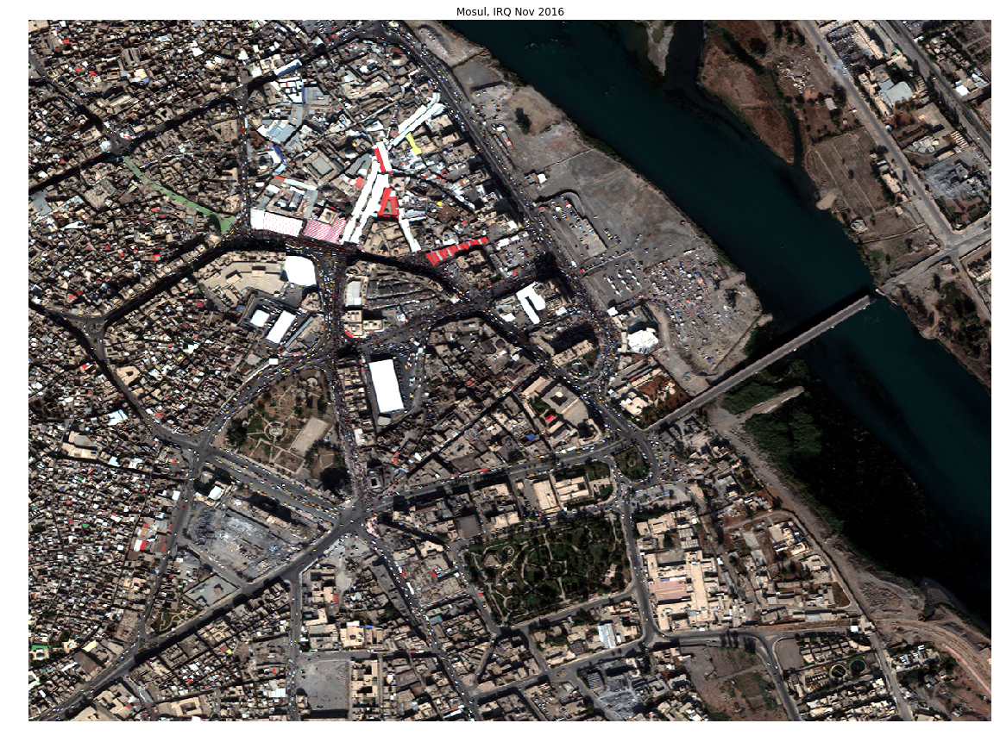

In [3]:
catalog_id_2016 = '1040010025191900'  # Mosul, IRQ -- BDA; 2016-11-11

image_bbox_wkt = 'POLYGON((43.13066461080268 36.34525376787812,43.146114134728464 36.34525376787812,43.146114134728464 36.333984236982346,43.13066461080268 36.333984236982346,43.13066461080268 36.34525376787812))'

image_rgb_2016 = order_or_display(catalog_id_2016, image_bbox_wkt, title_caption='Mosul, IRQ Nov 2016')


In [4]:
image_bbox_shape = shapely.wkt.loads(image_bbox_wkt)

image_bbox_bounds = image_bbox_shape.bounds

image_bbox = [image_bbox_bounds[0], image_bbox_bounds[1], image_bbox_bounds[2], image_bbox_bounds[3]]


strip1 = CatalogImage('1040010025191900', bbox= image_bbox)


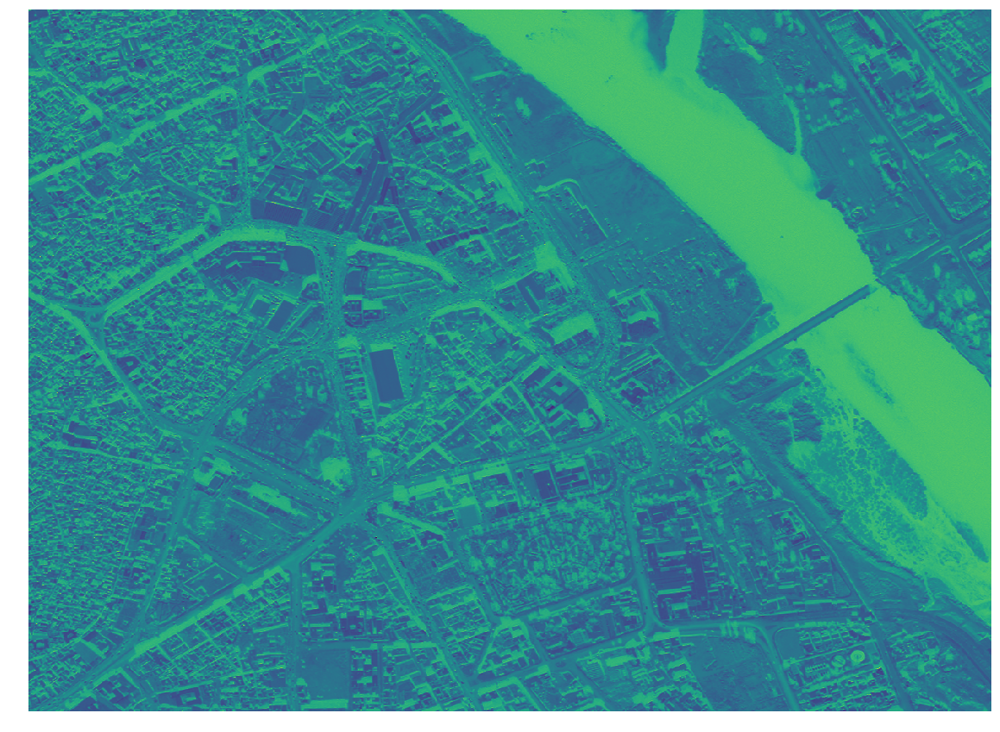

In [5]:
wvbi = (strip1[0,:,:] - strip1[5,:,:])/(strip1[0,:,:] + strip1[5,:,:])

basic_figure_plot(wvbi)

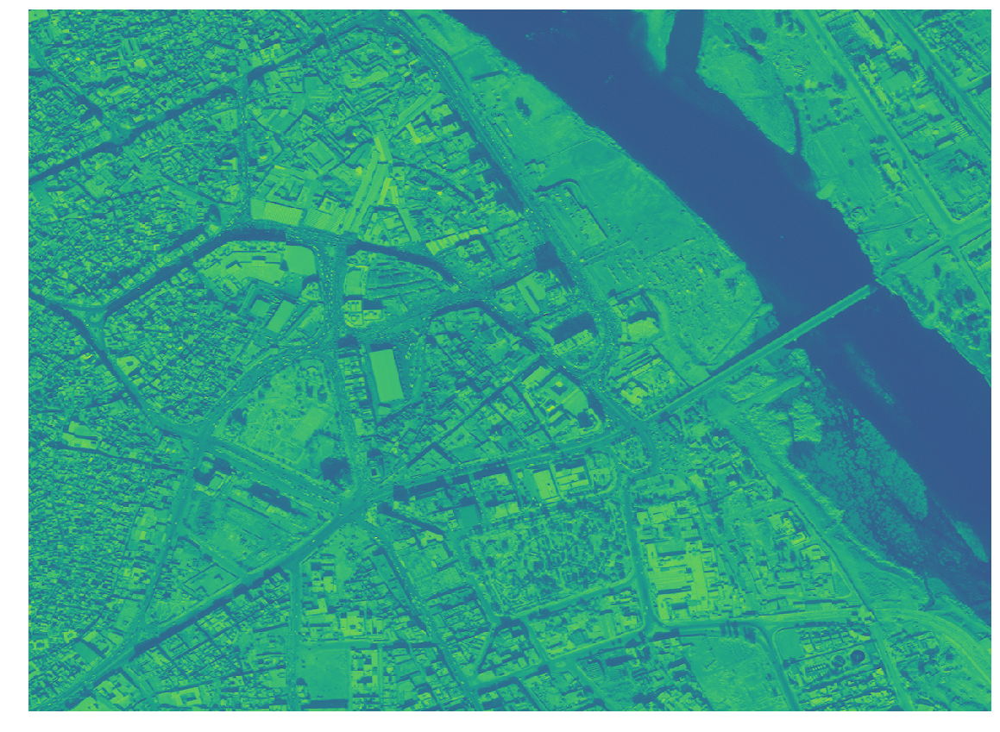

In [6]:
wvnhfd = (strip1[5,:,:] - strip1[0,:,:])/(strip1[5,:,:] + strip1[0,:,:])

basic_figure_plot(wvnhfd)

In [7]:
strip1.metadata

{'image': {'imageId': '006af36b-ea81-43cd-b82c-fd96b67e24ad',
  'version': 1.0,
  'profileName': 'georectified_image',
  'tileBucketName': 'idaho-images',
  'tilePartition': '0000',
  'nativeTileFileFormat': 'TIF',
  'tileXOffset': 0,
  'tileYOffset': 0,
  'numXTiles': 55,
  'numYTiles': 222,
  'tileXSize': 256,
  'tileYSize': 256,
  'numBands': 8,
  'dataType': 'FLOAT',
  'imageHeight': 56578,
  'imageWidth': 14071,
  'sensorPlatformName': 'WV03',
  'sensorName': '8-band (Coastal, Blue, Green, Yellow, Red, Red-edge, NIR1, NIR2) Multispectral',
  'vendorName': 'DigitalGlobe, Inc.',
  'vendorDatasetIdentifier': 'LV1B:056399340010_01_P001:1040010025191900:A01001028B3F6800',
  'acquisitionDate': '2016-11-11T08:11:25.489Z',
  'colorInterpretation': 'WORLDVIEW_8_BAND',
  'imageBoundsWGS84': 'POLYGON ((42.99572716 36.65693699, 43.16371457466044 36.65693699, 43.16371457466044 35.98147739603665, 42.99572716 35.98147739603665, 42.99572716 36.65693699))',
  'groundSampleDistanceMeters': 1.401,
 

In [8]:
time_string1 = strip1.metadata['image']['acquisitionDate']

In [9]:
strip2 = CatalogImage('1040010032486E00')

time_string2 = strip2.metadata['image']['acquisitionDate']

In [10]:
time_string2

'2017-08-18T08:22:41.475Z'

In [11]:
! pip install python-dateutil
import dateutil.parser

vcrpy 1.13.0 requires yarl, which is not installed.
twisted 18.7.0 requires PyHamcrest>=1.9.0, which is not installed.
mkl-random 1.0.1 requires cython, which is not installed.
gbdxtools 0.15.12 requires mock, which is not installed.
You are using pip version 10.0.1, however version 18.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [12]:
t1 = dateutil.parser.parse(time_string1) # window will be centered about the DG image timestamp

t1 = t1.strftime('%Y-%m-%dT%H:%M:%S')

print(t1)

t2 = dateutil.parser.parse(time_string2) # window will be centered about the DG image timestamp

t2 = t2.strftime('%Y-%m-%dT%H:%M:%S')

print(t2)



2016-11-11T08:11:25
2017-08-18T08:22:41


In [13]:
from datetime import datetime
s1 = t1
s2 = t2 # for example
FMT = '%Y-%m-%dT%H:%M:%S'
tdelta = datetime.strptime(s2, FMT) - datetime.strptime(s1, FMT)

print(tdelta)

280 days, 0:11:16


Strip raster dimensions: (8, 26056, 13295)
Strip geographic bounds: (43.05285236, 36.1429538760079, 43.213128051699606, 36.45706771)

Image raster dimensions: (8, 935, 1281)
Image geographic bounds: (43.13066461080268, 36.333984236982346, 43.146114134728464, 36.34525376787812)


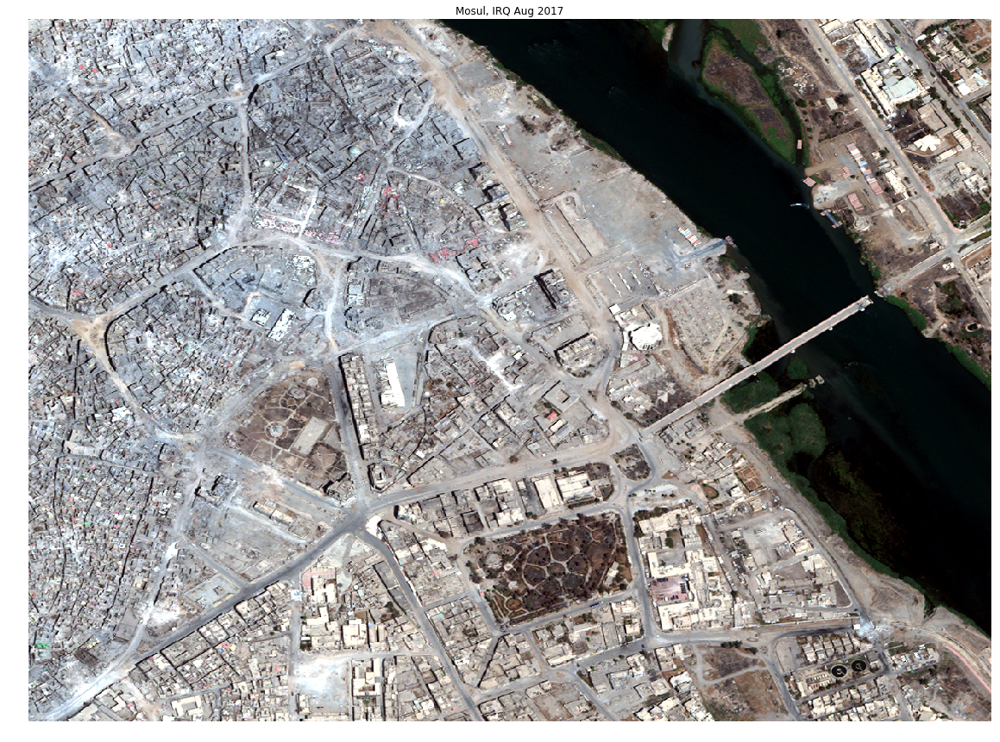

In [14]:
catalog_id_2017 = '1040010032486E00'  # Mosul, IRQ -- BDA; 2017-08-18 

image_rgb_2017 = order_or_display(catalog_id_2017, image_bbox_wkt, title_caption='Mosul, IRQ Aug 2017')


Strip raster dimensions: (8, 17180, 13185)
Strip geographic bounds: (43.05334203, 36.24273840512756, 43.205303537366156, 36.44074361533237)

Image raster dimensions: (8, 978, 1340)
Image geographic bounds: (43.13066461080268, 36.333984236982346, 43.146114134728464, 36.34525376787812)


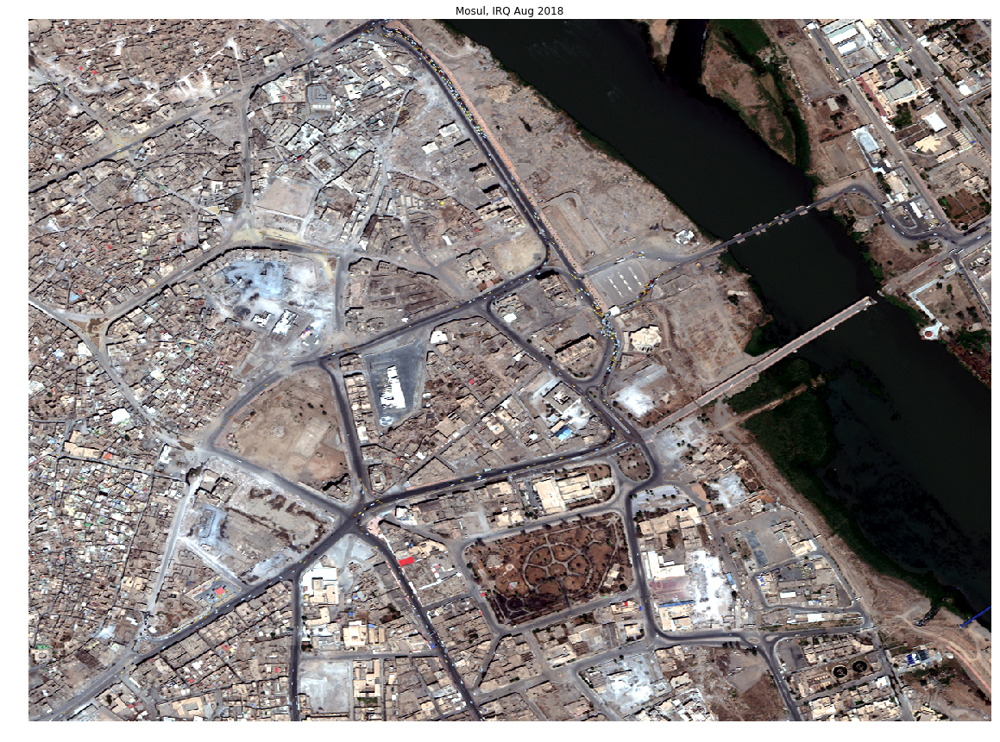

In [15]:
catalog_id_2018 = '1040010040B2A000'  # Mosul, IRQ -- BDA; 2018-08-22

image_rgb_2018 = order_or_display(catalog_id_2018, image_bbox_wkt, title_caption='Mosul, IRQ Aug 2018')


### Co-register the images in order to difference them

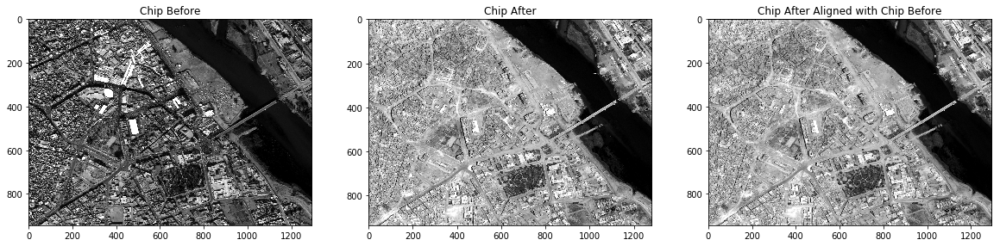

In [16]:
registered_image_gs_2017 = grayscale_and_coregister(image_rgb_2016, image_rgb_2017)


### Histogram match the grayscale images before differencing

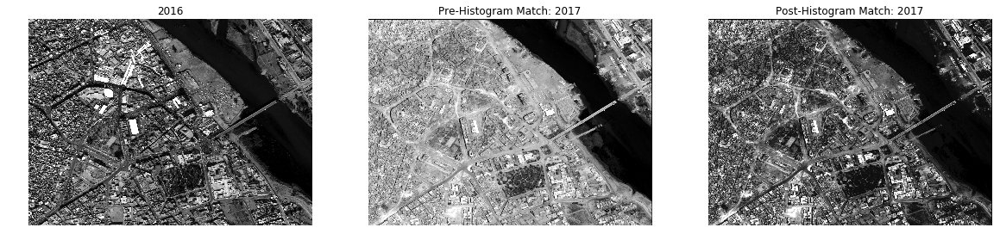

In [17]:
image_gs_2016 = rgb_to_grayscale(image_rgb_2016)

matched_registered_image_gs_2017 = histogram_match(registered_image_gs_2017, image_gs_2016, match_proportion=1.0)

plt.figure(figsize=(20, 20))

plt.subplot(1,3,1)
plt.title('2016')
plt.axis('off')
plt.imshow(image_gs_2016, cmap='gray')

plt.subplot(1,3,2)
plt.title('Pre-Histogram Match: 2017')
plt.axis('off')
plt.imshow(registered_image_gs_2017, cmap='gray')

plt.subplot(1,3,3)
plt.title('Post-Histogram Match: 2017')
plt.axis('off')
plt.imshow(matched_registered_image_gs_2017, cmap='gray')

plt.show()


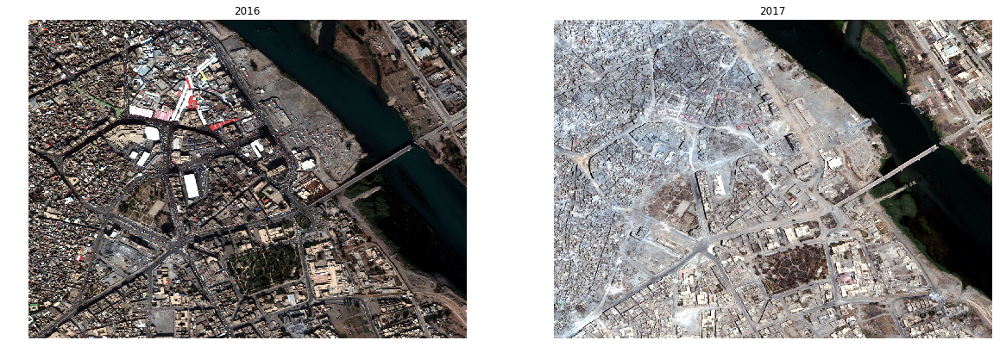

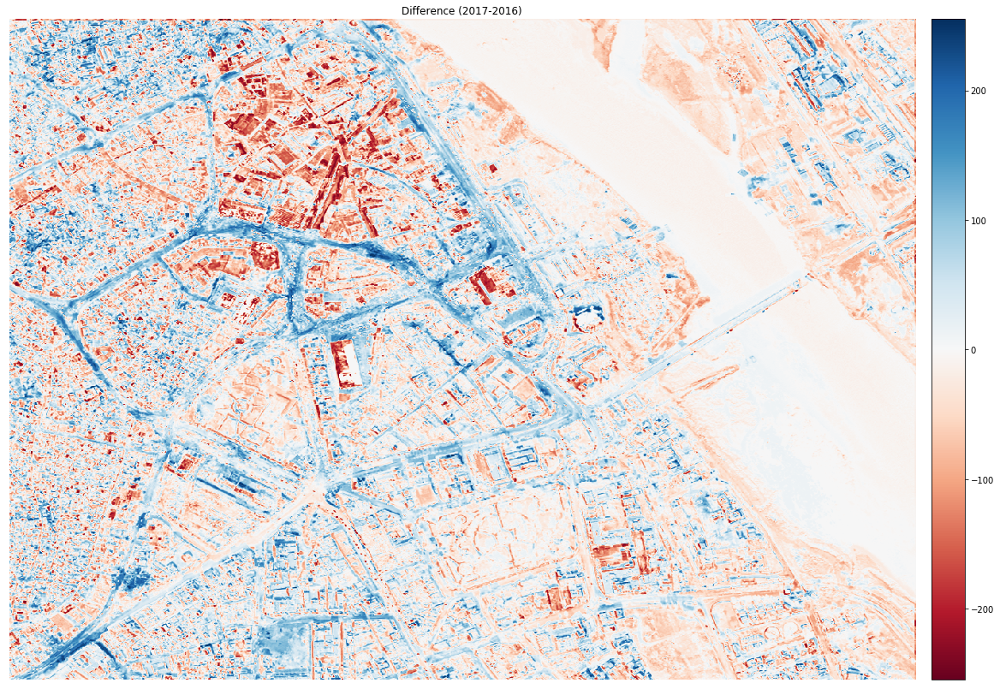

In [18]:
plt.figure(figsize=(20, 20))

plt.subplot(1,2,1)
plt.title('2016')
plt.axis('off')
plt.imshow(image_rgb_2016, cmap='gray')

plt.subplot(1,2,2)
plt.title('2017')
plt.axis('off')
plt.imshow(image_rgb_2017, cmap='gray')
plt.show()

difference_2016_2017 = matched_registered_image_gs_2017 - image_gs_2016

basic_change_detection_plot(difference_2016_2017, 
                            title_caption='Difference (2017-2016)', 
                            colorbar_status = 'on',
                            colormap_choice = 'RdBu'
                           )

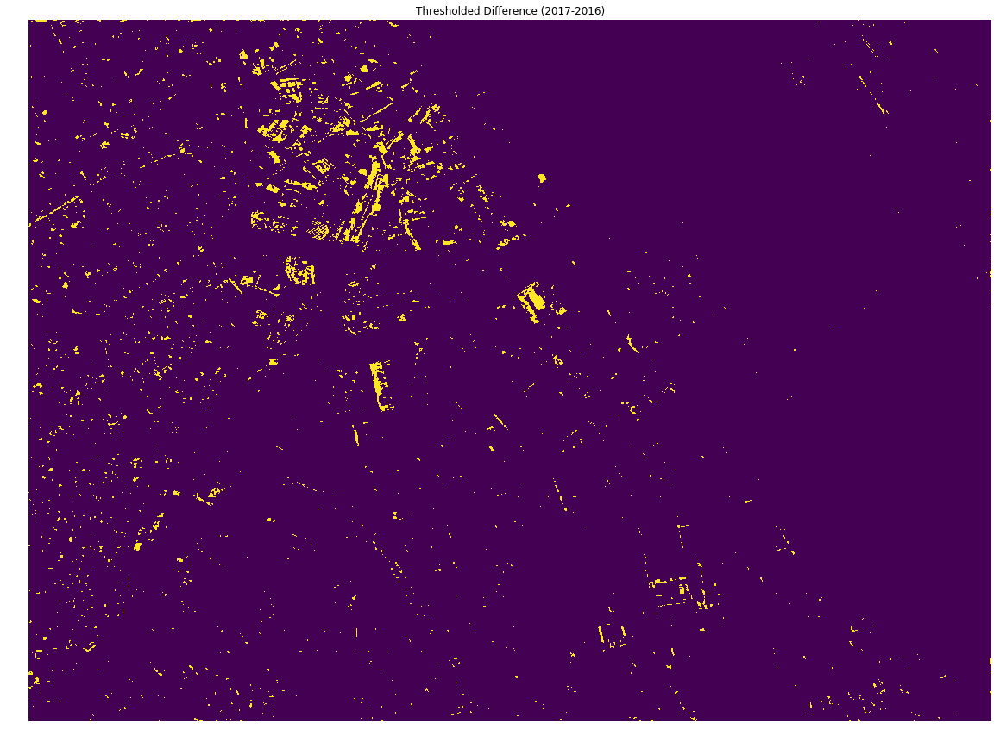

In [19]:
change_threshold = -150

threshold_difference = difference_2016_2017 < change_threshold

basic_figure_plot(difference_2016_2017 < change_threshold, title_caption = 'Thresholded Difference (2017-2016)')

### Perform raster region analysis on the thresholded difference image to count destroyed homes.

In [20]:
destroyed_pixels_threshold = 10

image_bbox_shape = shapely.wkt.loads(image_bbox_wkt)

image_bbox_bounds = image_bbox_shape.bounds

image_bbox = [image_bbox_bounds[0], image_bbox_bounds[1], image_bbox_bounds[2], image_bbox_bounds[3]]


image_2016 = CatalogImage(catalog_id_2016, bbox=image_bbox)

MSI_GSD = image_2016.metadata["image"]["groundSampleDistanceMeters"]

print()
print('MSI Image GSD:', MSI_GSD, 'm' )

destroyed_building_count = 0

building_area_coords = [] 


label_img = label(threshold_difference)

regions = regionprops(label_img)

for i, props in enumerate(regions):
        
    if props.area > destroyed_pixels_threshold:
        
        destroyed_building_count = destroyed_building_count + 1
        
        building_area_coords.append(props.coords)
    
print()
print('Damaged contiguous area threshold:', MSI_GSD**2 * destroyed_pixels_threshold, 'm^2')
print(destroyed_building_count, 'damageded buildings counted (i.e., buildings with damaged areas exceeding threshold.')



MSI Image GSD: 1.401 m

Damaged contiguous area threshold: 19.62801 m^2
389 damageded buildings counted (i.e., buildings with damaged areas exceeding threshold.


Damage overlay graphic generating...
100.00% complete


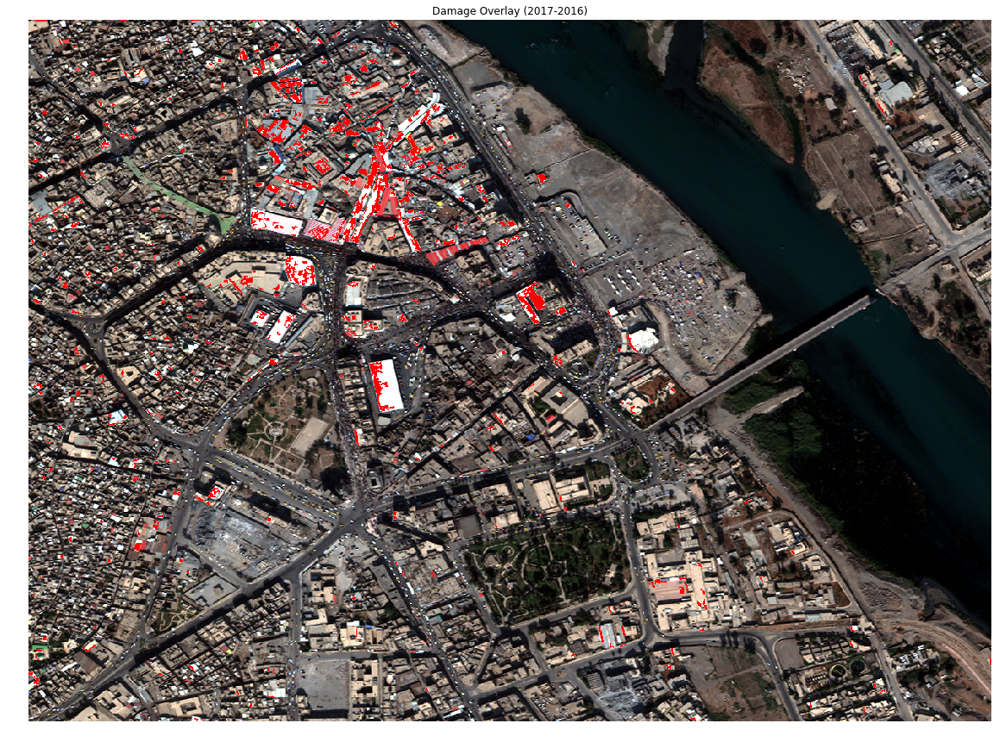

CPU times: user 2.33 s, sys: 216 ms, total: 2.55 s
Wall time: 2.26 s


In [21]:
%%time

dummy = image_2016.rgb()

damage_overlay = dummy

num_buildings = len(building_area_coords)

print('Damage overlay graphic generating...')

for index in range(num_buildings):
    
    single_building_coords = building_area_coords[index]
                  
    damage_overlay[single_building_coords[:,0],single_building_coords[:,1],0] = np.max(dummy)
    damage_overlay[single_building_coords[:,0],single_building_coords[:,1],1] = 0
    damage_overlay[single_building_coords[:,0],single_building_coords[:,1],2] = 0
        

            
print('100.00% complete') 

basic_figure_plot(damage_overlay, title_caption = 'Damage Overlay (2017-2016)')